# Object Detection with Faster R-CNN

In [1]:
!pip install wget

Defaulting to user installation because normal site-packages is not writeable


DEPRECATION: Loading egg at c:\programdata\anaconda3\lib\site-packages\vboxapi-1.0-py3.11.egg is deprecated. pip 23.3 will enforce this behaviour change. A possible replacement is to use pip for package installation..


In [2]:
import wget

!wget https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-Coursera/images%20/images_part_5/DLguys.jpeg
!wget https://www.ajot.com/images/uploads/article/quantas-car-v-plane-TAKE-OFF.jpg
!wget https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-CV0101EN-Coursera/images%20/images_part_5/istockphoto-187786732-612x612.jpeg
!wget https://cdn.webrazzi.com/uploads/2015/03/andrew-ng1.jpg

'wget' is not recognized as an internal or external command,
operable program or batch file.
'wget' is not recognized as an internal or external command,
operable program or batch file.
'wget' is not recognized as an internal or external command,
operable program or batch file.
'wget' is not recognized as an internal or external command,
operable program or batch file.


In [3]:
import torchvision 
from torchvision import transforms
import torch 
from torch import no_grad

In [4]:
import requests

In [5]:
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from colorama import Fore, Style

In [6]:
def get_predictions(pred, threshold=0.8, objects=None):
    """
    This function will assign a string name to a predicted class and eliminate predictions whose likelihood  is under a threshold 
    
    pred: a list where each element contains a tuple that corresponds to information about  the different objects; Each element includes a tuple with the class yhat, probability of belonging to that class and the coordinates of the bounding box corresponding to the object 
    image : frozen surface
    predicted_classes: a list where each element contains a tuple that corresponds to information about  the different objects; Each element includes a tuple with the class name, probability of belonging to that class and the coordinates of the bounding box corresponding to the object 
    thre
    """


    predicted_classes= [(COCO_INSTANCE_CATEGORY_NAMES[i],p,[(box[0], box[1]), (box[2], box[3])]) for i,p,box in zip(list(pred[0]['labels'].numpy()),pred[0]['scores'].detach().numpy(),list(pred[0]['boxes'].detach().numpy()))]
    predicted_classes=[  stuff  for stuff in predicted_classes  if stuff[1]>threshold ]
    
    if objects  and predicted_classes :
        predicted_classes=[ (name, p, box) for name, p, box in predicted_classes if name in  objects ]
    return predicted_classes

In [7]:
# ... (previous code)

def draw_box(pred_class, img, rect_th=2, text_size=0.5, text_th=2, download_image=False, img_name="img"):
    """
    Draws a box around each object.
    
    pred_class: A list where each element contains a tuple with information about different objects. 
                Each element includes a tuple with the class name, probability of belonging to that class, 
                and the coordinates of the bounding box corresponding to the object.
    img: The input image.
    rect_th: Thickness of the rectangle.
    text_size: Size of the text.
    text_th: Thickness of the text.
    download_image: Whether to download the image or not.
    img_name: Name of the image.
    """
    image_np = (np.clip(cv2.cvtColor(np.clip(img.numpy().transpose((1, 2, 0)), 0, 1), cv2.COLOR_RGB2BGR), 0, 1) * 255).astype(np.uint8).copy()

    for predicted_class in pred_class:
      
        label = predicted_class[0]
        probability = predicted_class[1]
        box = predicted_class[2]
        t = round(box[0][0].tolist())
        l = round(box[0][1].tolist())
        r = round(box[1][0].tolist())
        b = round(box[1][1].tolist())

        # Giving brief information about rectangle, class, and probability.
        from colorama import Fore
        from colorama import Style
        print(f"\nLabel: {Fore.GREEN}{label}{Style.RESET_ALL}")
        print(f"Box coordinates: {t}, {l}, {r}, {b}")
        print(f"Probability: {probability}")

        # Drawing rectangle and adding text on the picture based on their class and size.
        cv2.rectangle(image_np, (t, l), (r, b), (0, 255, 0), rect_th)
        cv2.rectangle(image_np, (t, l), (t+110, l+17), (255, 255, 255), -1)
        cv2.putText(image_np, label, (t+10, l+12),  cv2.FONT_HERSHEY_SIMPLEX, text_size, (0, 255, 0), thickness=text_th)
        cv2.putText(image_np, f"{label}: {round(probability, 2)}", (t+10, l+12),  cv2.FONT_HERSHEY_SIMPLEX, text_size, (0, 255, 0), thickness=text_th)

    # Plotting image
    image_np = np.array(image_np)
    plt.figure(figsize=(15, 10))
    plt.imshow(cv2.cvtColor(image_np, cv2.COLOR_BGR2RGB))
    if download_image:
        plt.savefig(f'{img_name}.png')
    else:
        pass
    plt.show()

# ... (continue with the rest of the code)


In [8]:
def save_RAM(image_=False):
    global image, img, pred
    torch.cuda.empty_cache()
    del(img)
    del(pred)
    if image_:
        image.close()
        del(image)

# Load Pre-trained Faster R-CNN

In [9]:
model_ = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights='FasterRCNN_ResNet50_FPN_Weights.DEFAULT')
model_.eval()

for name, param in model_.named_parameters():
    param.requires_grad = False
print("done")

done


In [10]:
def model(x):
    with torch.no_grad():
        yhat = model_(x)
    return yhat

In [11]:
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]
len(COCO_INSTANCE_CATEGORY_NAMES)

91

# Object Localization

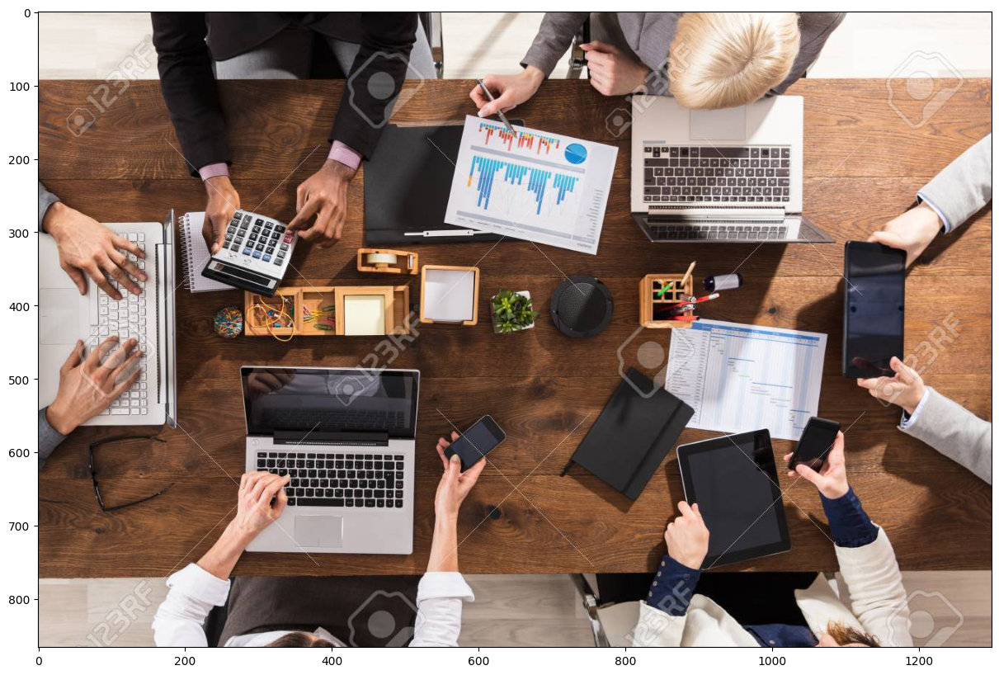

In [12]:
img_path='laptop.jpg'
half = 0.5
image = Image.open(img_path)

image.resize([int(half * s) for s in image.size] )
plt.figure(figsize=(15, 10))
plt.imshow(image)
plt.show()

In [13]:
transform = transforms.Compose([transforms.ToTensor()])

In [14]:
img = transform(image)

In [15]:
img

tensor([[[0.9216, 0.9216, 0.9255,  ..., 0.9725, 0.9725, 0.9725],
         [0.9137, 0.9137, 0.9137,  ..., 0.9725, 0.9725, 0.9725],
         [0.9294, 0.9294, 0.9333,  ..., 0.9765, 0.9765, 0.9765],
         ...,
         [0.8471, 0.8510, 0.8510,  ..., 0.6902, 0.6902, 0.6902],
         [0.8431, 0.8431, 0.8431,  ..., 0.6902, 0.6902, 0.6902],
         [0.8431, 0.8431, 0.8431,  ..., 0.6902, 0.6902, 0.6902]],

        [[0.8941, 0.8941, 0.8980,  ..., 0.9529, 0.9529, 0.9529],
         [0.8863, 0.8863, 0.8863,  ..., 0.9529, 0.9529, 0.9529],
         [0.9020, 0.9020, 0.9059,  ..., 0.9569, 0.9569, 0.9569],
         ...,
         [0.7922, 0.7961, 0.7961,  ..., 0.5804, 0.5804, 0.5804],
         [0.7882, 0.7882, 0.7882,  ..., 0.5882, 0.5882, 0.5882],
         [0.7882, 0.7882, 0.7882,  ..., 0.5882, 0.5882, 0.5882]],

        [[0.8627, 0.8627, 0.8667,  ..., 0.9412, 0.9412, 0.9412],
         [0.8549, 0.8549, 0.8549,  ..., 0.9412, 0.9412, 0.9412],
         [0.8706, 0.8706, 0.8745,  ..., 0.9451, 0.9451, 0.

In [16]:
pred = model([img])

In [17]:
len(pred[0]['labels'])

99

In [18]:
pred[0]['labels']

tensor([77, 73, 77,  1,  1,  1,  1,  1, 77, 84, 84, 73,  1, 73,  1,  1,  1,  1,
         1,  1,  1, 84, 77,  1,  1,  1,  1,  1,  1, 84, 49, 67,  1,  1, 49,  1,
         1, 76, 73,  1,  1, 74,  1, 67, 84, 48, 63, 50,  1,  1, 67, 73,  1, 84,
        49, 49, 63, 84,  1, 67, 87, 15, 49, 49, 84, 56,  1,  1, 87, 76, 67, 15,
         1,  1, 67, 73, 73, 67,  1,  1,  1, 67, 72, 76, 49, 73, 85, 84, 60, 49,
        59, 84, 77, 76, 89,  1, 62, 73, 84])

In [19]:
pred[0]['scores']

tensor([0.9993, 0.9900, 0.9896, 0.9754, 0.9605, 0.8706, 0.8653, 0.8633, 0.8486,
        0.8449, 0.8219, 0.8179, 0.8002, 0.7315, 0.6812, 0.6710, 0.6687, 0.6528,
        0.6435, 0.6432, 0.6384, 0.6179, 0.6104, 0.6026, 0.5821, 0.5349, 0.5019,
        0.4996, 0.4864, 0.4512, 0.4489, 0.3888, 0.3838, 0.3734, 0.3428, 0.3347,
        0.3291, 0.3181, 0.3036, 0.2595, 0.2556, 0.2442, 0.2044, 0.1926, 0.1903,
        0.1858, 0.1850, 0.1827, 0.1769, 0.1702, 0.1558, 0.1483, 0.1424, 0.1409,
        0.1366, 0.1346, 0.1260, 0.1174, 0.1089, 0.1084, 0.1079, 0.1076, 0.1042,
        0.1011, 0.0995, 0.0966, 0.0959, 0.0911, 0.0904, 0.0856, 0.0850, 0.0836,
        0.0821, 0.0749, 0.0746, 0.0746, 0.0743, 0.0730, 0.0705, 0.0696, 0.0682,
        0.0665, 0.0656, 0.0653, 0.0627, 0.0618, 0.0607, 0.0598, 0.0597, 0.0592,
        0.0581, 0.0574, 0.0562, 0.0561, 0.0538, 0.0528, 0.0524, 0.0519, 0.0500])

In [20]:
index=pred[0]['labels'][0].item()
COCO_INSTANCE_CATEGORY_NAMES[index]

'cell phone'

In [21]:
bounding_box=pred[0]['boxes'][0].tolist()
bounding_box

[1022.6583862304688, 550.6614379882812, 1096.4232177734375, 631.4130249023438]

In [22]:
t, l, r, b = [round(x) for x in bounding_box]
print(t, l, r, b)

1023 551 1096 631


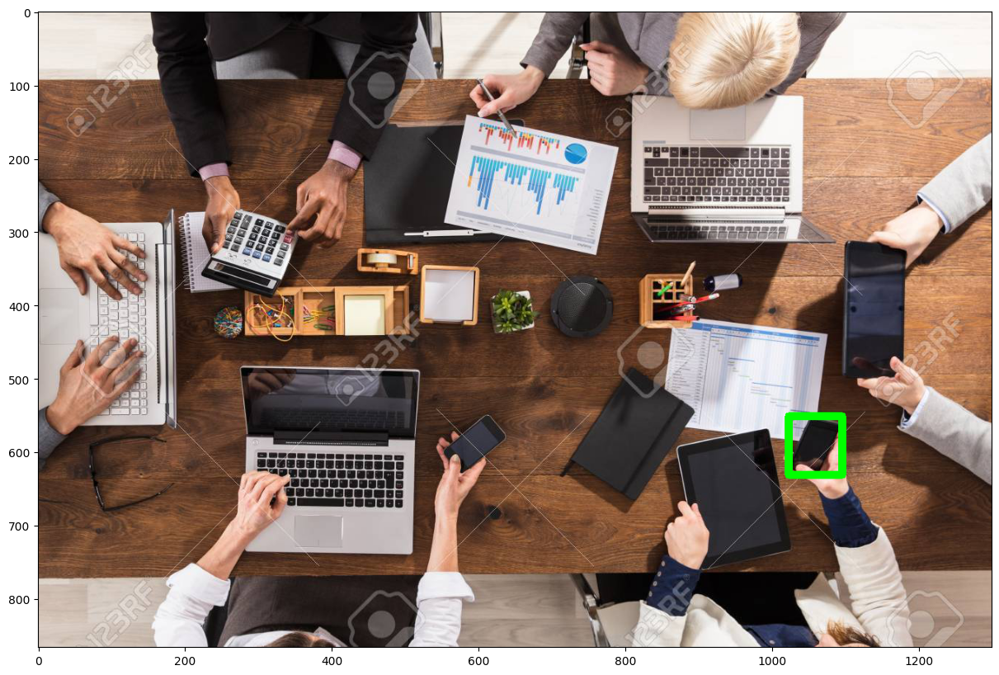

In [23]:
img_plot=(np.clip(cv2.cvtColor(np.clip(img.numpy().transpose((1, 2, 0)), 0, 1), cv2.COLOR_RGB2BGR), 0, 1) * 255).astype(np.uint8)
cv2.rectangle(img_plot, (t, l), (r, b), (0, 255, 0), 10) # Draw Rectangle with the coordinates
plt.figure(figsize=(15, 10))
plt.imshow(cv2.cvtColor(img_plot, cv2.COLOR_BGR2RGB))
plt.show()
del img_plot, t, l, r, b


Label: person
Box coordinates: 1135, 169, 1294, 343
Probability: 0.9754126071929932

Label: person
Box coordinates: 179, 5, 530, 331
Probability: 0.9604546427726746

Label: person
Box coordinates: 1111, 173, 1300, 653
Probability: 0.8705682158470154

Label: person
Box coordinates: 1126, 470, 1295, 649
Probability: 0.8652615547180176

Label: person
Box coordinates: 587, 2, 1067, 139
Probability: 0.8633017539978027

Label: person
Box coordinates: 4, 228, 155, 396
Probability: 0.8002222180366516


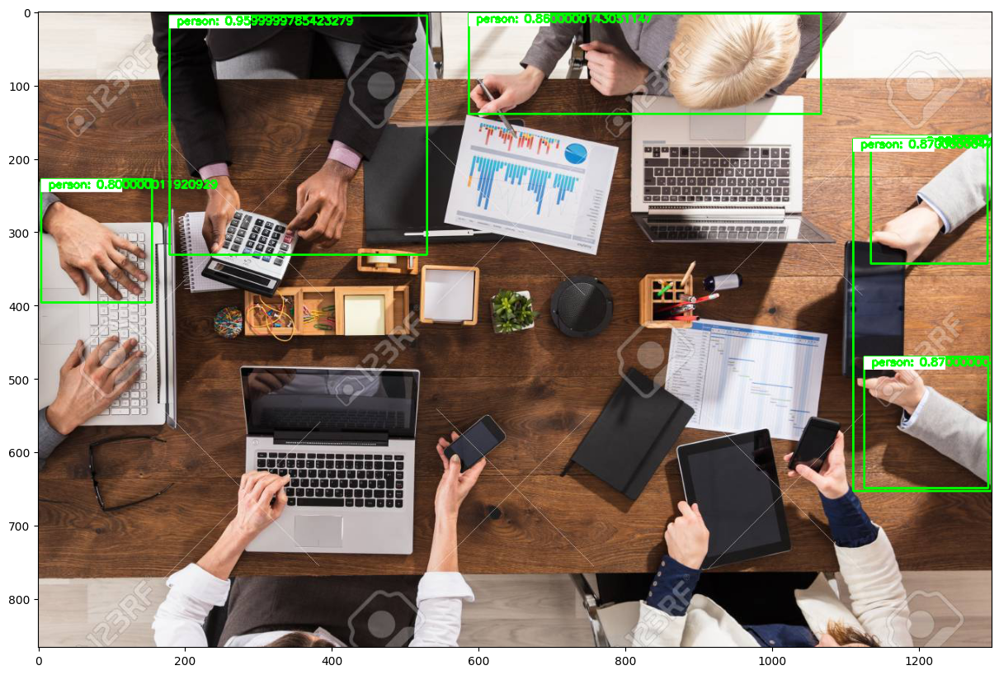

In [24]:
pred_class=get_predictions(pred, objects="person")
draw_box(pred_class, img)

del pred_class

In [25]:
get_predictions(pred, threshold=1, objects="person")

[]

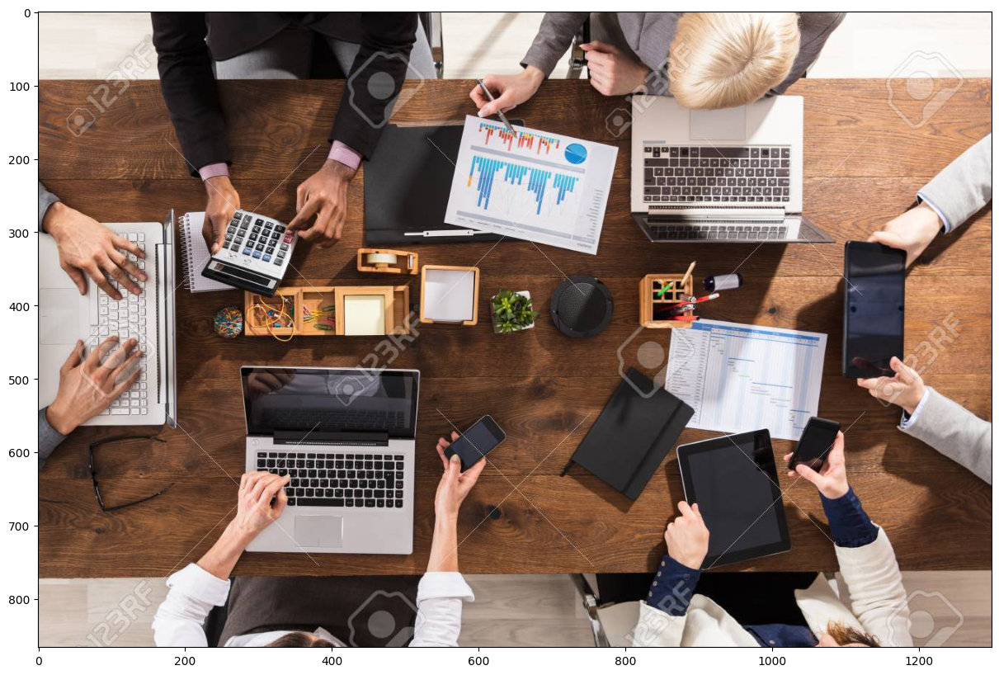

In [26]:
pred_thresh=get_predictions(pred, threshold=0.98, objects="person")
draw_box(pred_thresh, img, download_image=True, img_name="andrew_BOX")
del pred_thresh

In [27]:
save_RAM(image_=True)

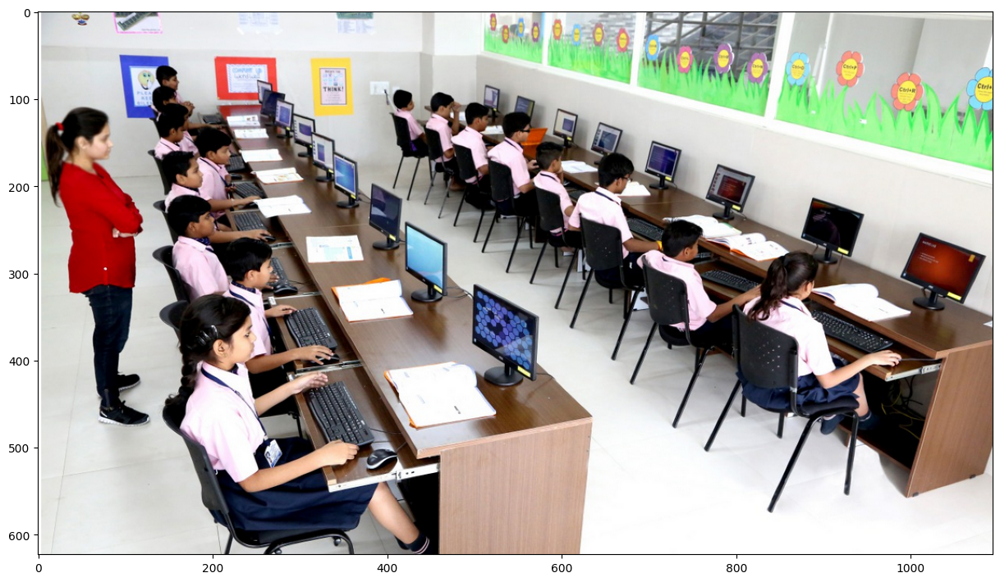

In [28]:
img_path='computerlab.png'
image = Image.open(img_path)
image.resize([int(half * s) for s in image.size])
plt.figure(figsize=(15, 10))
plt.imshow(np.array(image))
plt.show()


Label: person
Box coordinates: 13, 111, 125, 469
Probability: 0.9990866184234619

Label: mouse
Box coordinates: 376, 502, 413, 527
Probability: 0.9933642148971558

Label: tv
Box coordinates: 418, 242, 469, 330
Probability: 0.9814993739128113

Label: chair
Box coordinates: 152, 454, 381, 622
Probability: 0.9730544686317444

Label: tv
Box coordinates: 874, 216, 947, 284
Probability: 0.9695213437080383

Label: chair
Box coordinates: 803, 342, 961, 569
Probability: 0.9652857184410095

Label: person
Box coordinates: 144, 329, 464, 603
Probability: 0.9614900946617126

Label: person
Box coordinates: 473, 104, 526, 210
Probability: 0.9588261842727661

Label: tv
Box coordinates: 494, 313, 576, 433
Probability: 0.9528830647468567

Label: keyboard
Box coordinates: 308, 423, 384, 504
Probability: 0.9486503005027771

Label: chair
Box coordinates: 406, 113, 453, 219
Probability: 0.9360942244529724

Label: keyboard
Box coordinates: 760, 294, 822, 321
Probability: 0.9315563440322876

Label: person
Bo

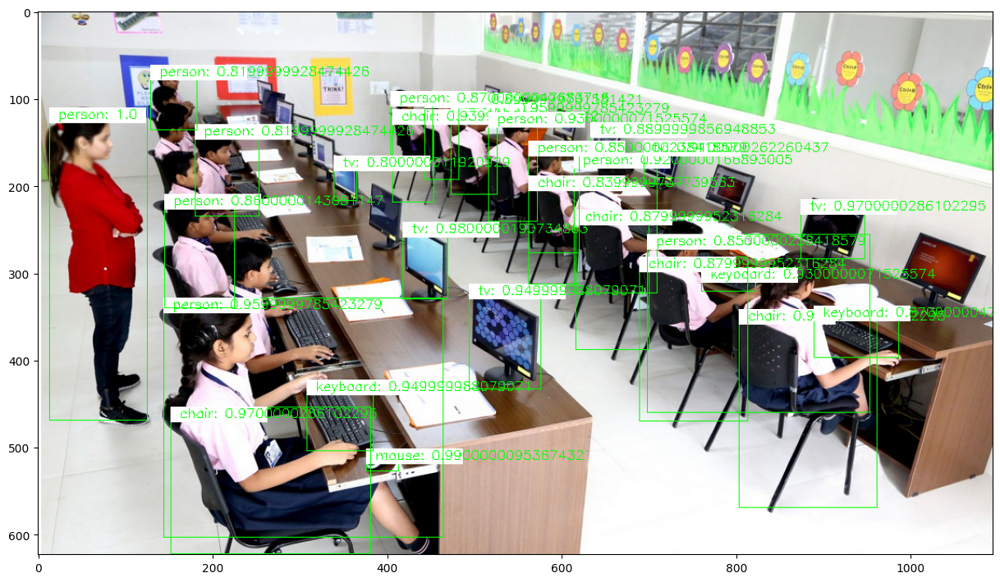

In [29]:
img = transform(image)
pred = model([img])
pred_thresh=get_predictions(pred, threshold=0.8)
draw_box(pred_thresh, img, rect_th=1, text_size= 0.5, text_th=1)

del pred_thresh


Label: person
Box coordinates: 13, 111, 125, 469
Probability: 0.9990866184234619

Label: person
Box coordinates: 144, 329, 464, 603
Probability: 0.9614900946617126

Label: person
Box coordinates: 473, 104, 526, 210
Probability: 0.9588261842727661

Label: person
Box coordinates: 516, 116, 572, 241
Probability: 0.9304965734481812

Label: person
Box coordinates: 614, 163, 709, 323
Probability: 0.9235334992408752

Label: person
Box coordinates: 443, 94, 482, 193
Probability: 0.8974785208702087

Label: person
Box coordinates: 404, 92, 452, 171
Probability: 0.8681938648223877

Label: person
Box coordinates: 145, 210, 225, 340
Probability: 0.8598132729530334

Label: person
Box coordinates: 698, 256, 953, 460
Probability: 0.8516793251037598

Label: person
Box coordinates: 562, 149, 620, 277
Probability: 0.8450663089752197

Label: person
Box coordinates: 180, 130, 253, 235
Probability: 0.820900559425354

Label: person
Box coordinates: 129, 62, 182, 136
Probability: 0.8185113072395325


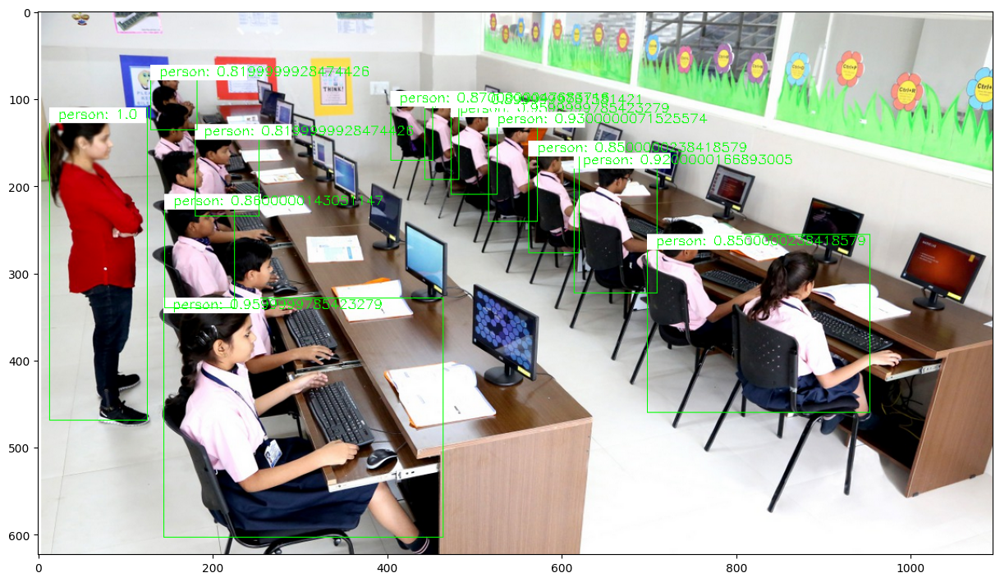

In [30]:
pred_obj=get_predictions(pred,objects="person")
draw_box(pred_obj, img, rect_th=1,text_size= 0.5, text_th=1, download_image=True, img_name="dl_guys_IBM_BOX")

del pred_obj


Label: person
Box coordinates: 13, 111, 125, 469
Probability: 0.9990866184234619

Label: mouse
Box coordinates: 376, 502, 413, 527
Probability: 0.9933642148971558

Label: tv
Box coordinates: 418, 242, 469, 330
Probability: 0.9814993739128113

Label: chair
Box coordinates: 152, 454, 381, 622
Probability: 0.9730544686317444

Label: tv
Box coordinates: 874, 216, 947, 284
Probability: 0.9695213437080383

Label: chair
Box coordinates: 803, 342, 961, 569
Probability: 0.9652857184410095

Label: person
Box coordinates: 144, 329, 464, 603
Probability: 0.9614900946617126

Label: person
Box coordinates: 473, 104, 526, 210
Probability: 0.9588261842727661

Label: tv
Box coordinates: 494, 313, 576, 433
Probability: 0.9528830647468567

Label: keyboard
Box coordinates: 308, 423, 384, 504
Probability: 0.9486503005027771

Label: chair
Box coordinates: 406, 113, 453, 219
Probability: 0.9360942244529724

Label: keyboard
Box coordinates: 760, 294, 822, 321
Probability: 0.9315563440322876

Label: person
Bo

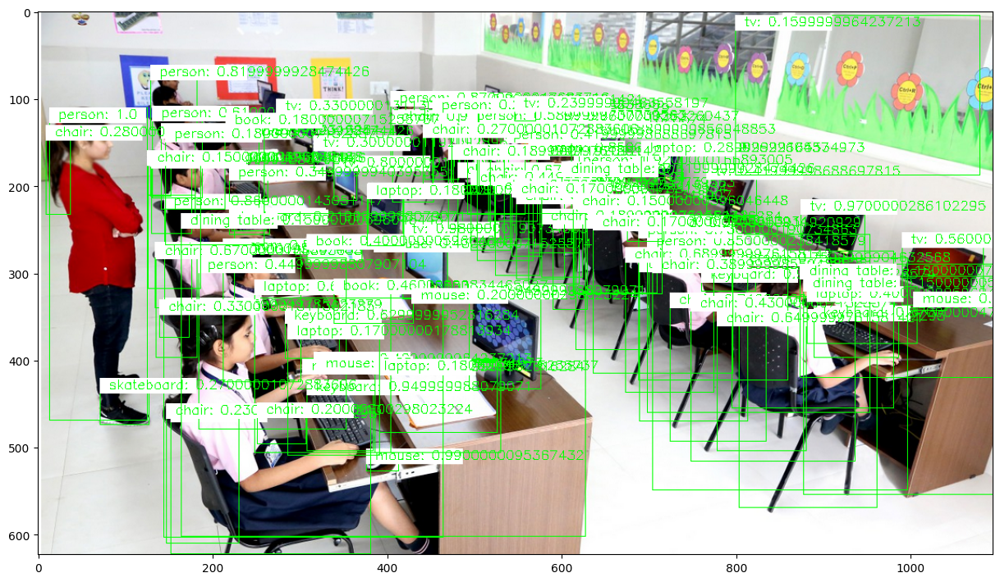

In [31]:
pred_thresh=get_predictions(pred,threshold=0.01)
draw_box(pred_thresh, img, rect_th= 1, text_size=0.5, text_th=1)

del pred_thresh

# Object Detection

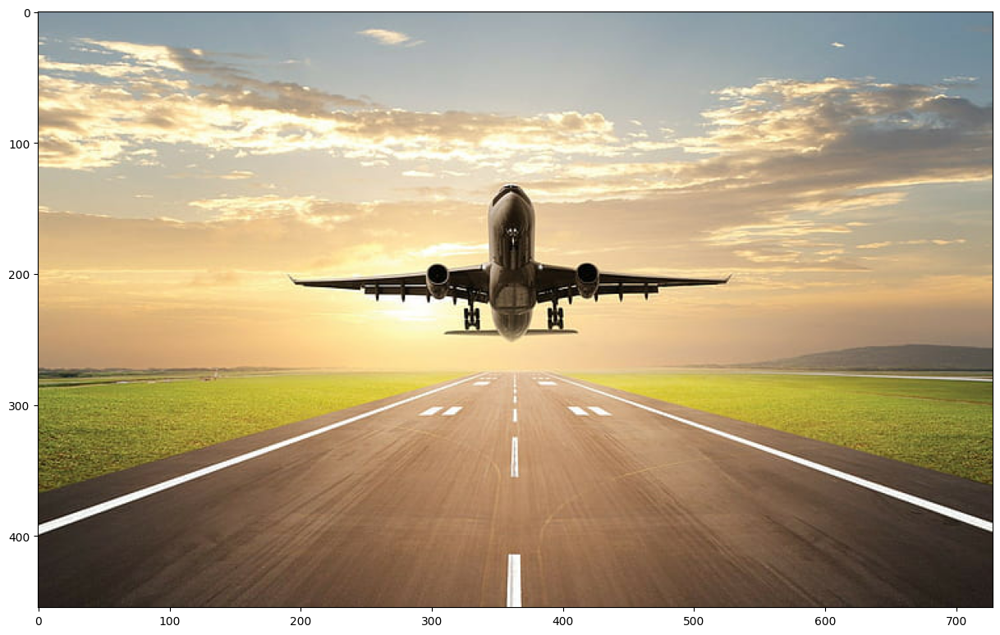

In [32]:
img_path='plane.jpg'
image = Image.open(img_path)
image.resize( [int(half * s) for s in image.size])
plt.figure(figsize=(15, 10))
plt.imshow(np.array(image))
plt.show()
del img_path


Label: airplane
Box coordinates: 189, 136, 531, 249
Probability: 0.9988422989845276


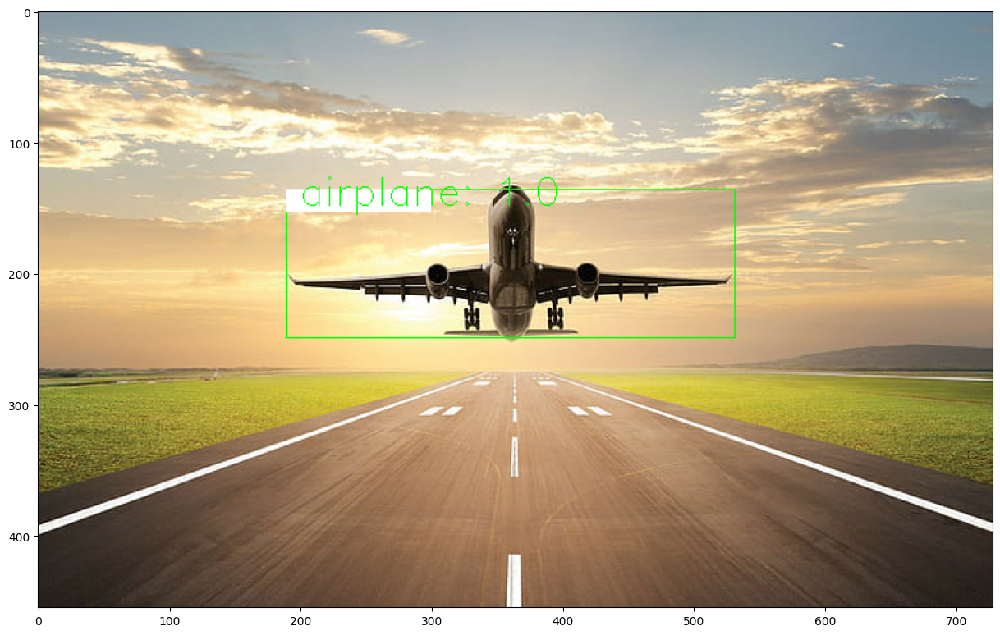

In [33]:
img = transform(image)
pred = model([img])
pred_thresh=get_predictions(pred,threshold=0.97)
draw_box(pred_thresh,img,rect_th=1, text_size=1, text_th=1, download_image=True, img_name="dog_cat_bird_BOX")

del pred_thresh

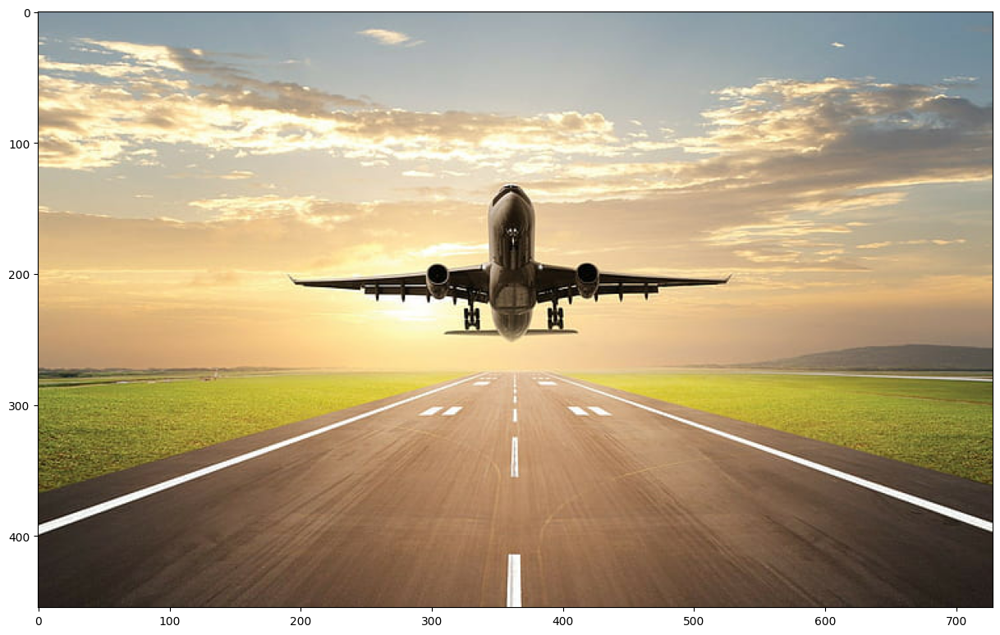

In [34]:
# img = transform(image)
# pred = model([img])
pred_obj=get_predictions(pred, objects=["dog","cat"])
draw_box(pred_obj, img,rect_th=1, text_size= 0.5, text_th=1)
del pred_obj

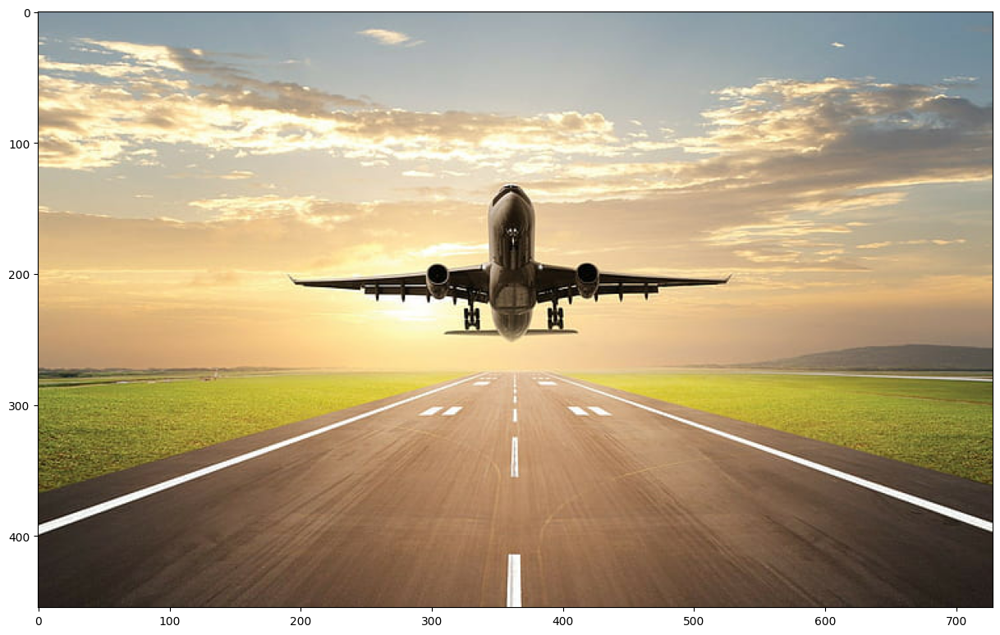

In [35]:
# img = transform(image)
# pred = model([img])
pred_thresh=get_predictions(pred, threshold=0.70, objects=["dog", "cat"])
draw_box(pred_thresh, img, rect_th= 1, text_size=1, text_th=1)

del pred_thresh

In [36]:
save_RAM(image_=True)

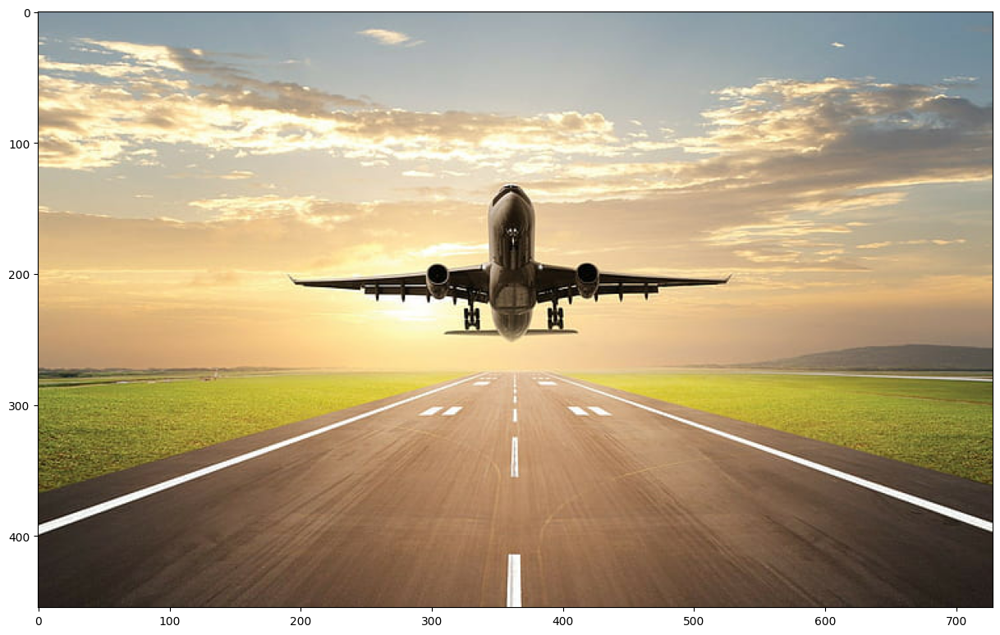

In [37]:
img_path='plane.jpg'
image = Image.open(img_path)
image.resize( [int(half * s) for s in image.size])
plt.figure(figsize=(15, 10))
plt.imshow(np.array(image))
plt.show()
del img_path


Label: airplane
Box coordinates: 189, 136, 531, 249
Probability: 0.9988422989845276


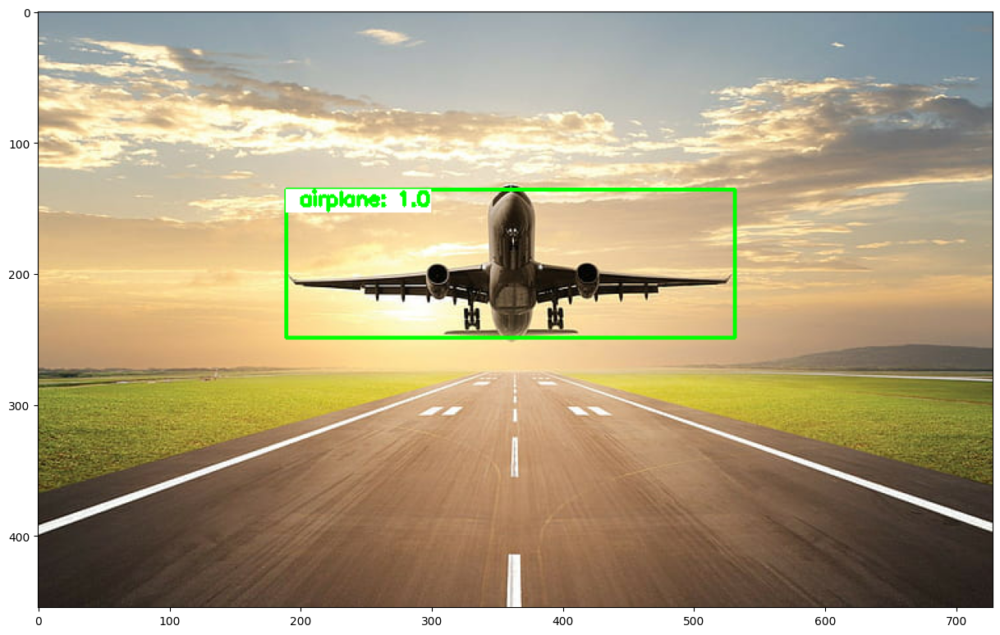

In [38]:
img = transform(image)
pred = model([img])
pred_thresh=get_predictions(pred, threshold=0.997)
draw_box(pred_thresh, img, download_image=True, img_name="car_plane_BOX")
del pred_thresh

In [39]:
save_RAM(image_=True)

# Test Model With an Uploaded Image

In [40]:
from pathlib import Path
print("Directory Path:", Path().absolute())

Directory Path: C:\Users\Ramesh


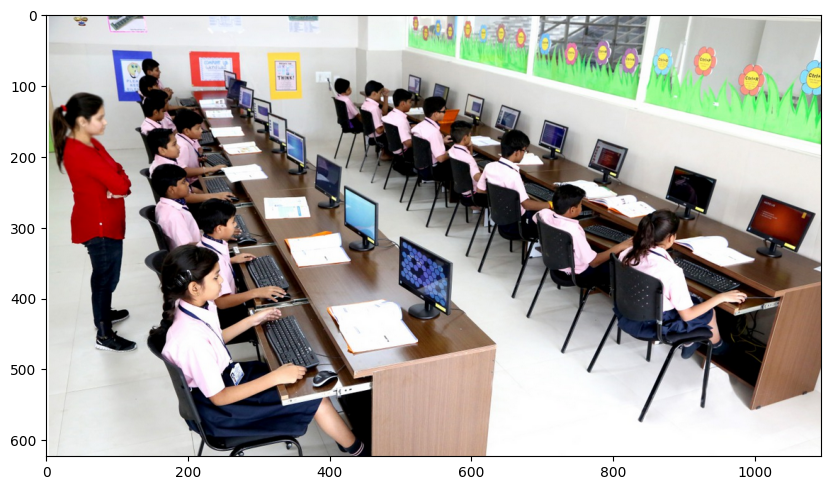

In [41]:
img_path = 'computerlab.png'
image = Image.open(img_path)
plt.figure(figsize=(10, 15))
plt.imshow(np.array(image))
plt.show()


Label: person
Box coordinates: 13, 111, 125, 469
Probability: 0.9990866184234619

Label: mouse
Box coordinates: 376, 502, 413, 527
Probability: 0.9933642148971558

Label: tv
Box coordinates: 418, 242, 469, 330
Probability: 0.9814993739128113

Label: chair
Box coordinates: 152, 454, 381, 622
Probability: 0.9730544686317444

Label: tv
Box coordinates: 874, 216, 947, 284
Probability: 0.9695213437080383

Label: chair
Box coordinates: 803, 342, 961, 569
Probability: 0.9652857184410095

Label: person
Box coordinates: 144, 329, 464, 603
Probability: 0.9614900946617126

Label: person
Box coordinates: 473, 104, 526, 210
Probability: 0.9588261842727661

Label: tv
Box coordinates: 494, 313, 576, 433
Probability: 0.9528830647468567


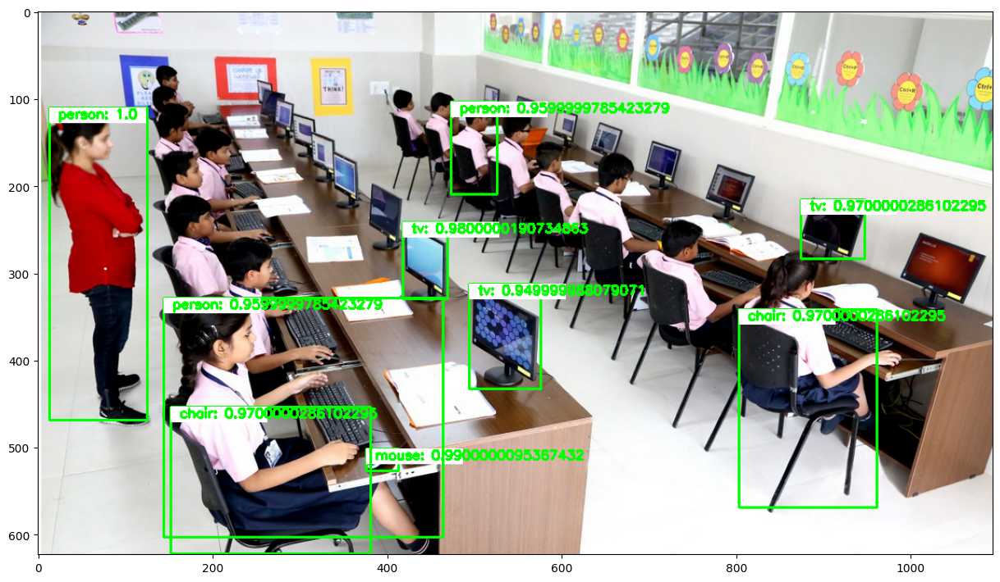

In [42]:
img = transform(image )
pred = model(img.unsqueeze(0))
pred_thresh=get_predictions(pred,threshold=0.95)
draw_box(pred_thresh, img, download_image=True, img_name="me_BOX")